In [104]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from surprise import SVD
from surprise import Dataset
from surprise.model_selection import cross_validate
pd.set_option('mode.chained_assignment', None)
pd.set_option('display.max_colwidth',None)

In [105]:
users = pd.read_csv('New_Users.csv',low_memory=False)
ratings = pd.read_csv('New_Ratings.csv',low_memory=False)
books = pd.read_csv('Book_Information.csv',low_memory=False)

In [106]:
print(books.shape)
data1 = books[["Book-Title", "Description"]]
books.columns=["ISBN", "Book-Title", "Book-Author", "Year-Of-Publication", "Publisher", "Image-URL-S",\
         "Image-URL-M", "Image-URL-L", "Description", "Page Count", "Genre", "Average Rating", "Rating Count"]
books.drop(["Image-URL-S","Image-URL-L","Description","Page Count", "Genre", "Average Rating", "Rating Count"],axis=1,inplace=True)
books.head()

(49992, 13)


,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-M
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.01.MZZZZZZZ.jpg
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.01.MZZZZZZZ.jpg
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.01.MZZZZZZZ.jpg
3,0374157065,Flu: The Story of the Great Influenza Pandemic of 1918 and the Search for the Virus That Caused It,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.01.MZZZZZZZ.jpg
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.01.MZZZZZZZ.jpg


now let us start from books dataframe. first we will check if there are NULL values

In [60]:
L=((books.isnull().sum()).sort_values()).to_dict()
for i in L:
    print(i,"--->",L[i])  

ISBN ---> 0
Book-Title ---> 0
Book-Author ---> 0
Year-Of-Publication ---> 0
Publisher ---> 0
Image-URL-M ---> 0


In [61]:
books.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49992 entries, 0 to 49991
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   ISBN                 49992 non-null  object
 1   Book-Title           49992 non-null  object
 2   Book-Author          49992 non-null  object
 3   Year-Of-Publication  49992 non-null  int64 
 4   Publisher            49992 non-null  object
 5   Image-URL-M          49992 non-null  object
dtypes: int64(1), object(5)
memory usage: 2.3+ MB


In [62]:
duplicateRowsDF = books[books.duplicated()]
duplicateRowsDF.shape

(0, 6)

we do not have duplicate rows now we will check if the isbn or the title is repeated

In [63]:
print("unique isbn: ",len(books["ISBN"].unique()))
print("total rows: ",books.shape[0])
print("unique title: ",len(books["Book-Title"].unique()))
print("total rows: ",books.shape[0])

unique isbn:  49992
total rows:  49992
unique title:  46235
total rows:  49992


we can see that some titles are repeated

In [64]:
books["Book-Author"].fillna("Unknown",inplace=True)
books['Publisher'].fillna("Unknown",inplace=True)
books.isnull().sum()

ISBN                   0
Book-Title             0
Book-Author            0
Year-Of-Publication    0
Publisher              0
Image-URL-M            0
dtype: int64

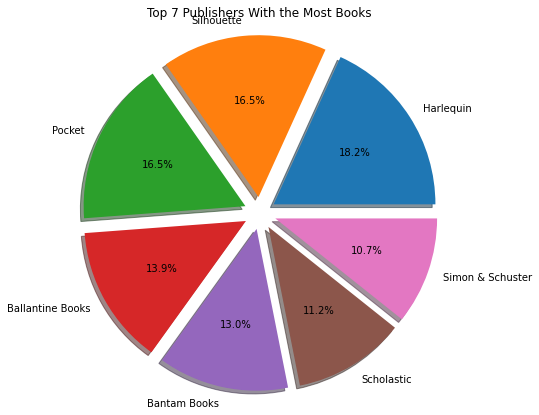

In [65]:
my_dict=(books['Publisher'].value_counts()).to_dict()
count= pd.DataFrame(list(my_dict.items()),columns = ['c','count'])
a = count.sort_values(by=['count'], ascending = False)
a.head(7)
labels = 'Harlequin','Silhouette','Pocket','Ballantine Books','Bantam Books','Scholastic','Simon & Schuster'
sizes = [count['count'].iloc[0],count['count'].iloc[1],count['count'].iloc[2],count['count'].iloc[3],count['count'].iloc[4],
         count['count'].iloc[5],count['count'].iloc[6]]
explode = (0.1, 0.1, 0.1, 0.1,0.1, 0.1,0.1 )
fig1 , ax1 = plt.subplots(figsize=(7,7))
ax1.pie(sizes,
        explode = explode,
        labels = labels,
        autopct = '%1.1f%%',
        shadow = True,
        startangle = 0)
plt.title("Top 7 Publishers With the Most Books")
ax1.axis ('equal')
plt.show()

<ipython-input-66-faf8a6c0afa6>:7: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90,horizontalalignment='center')


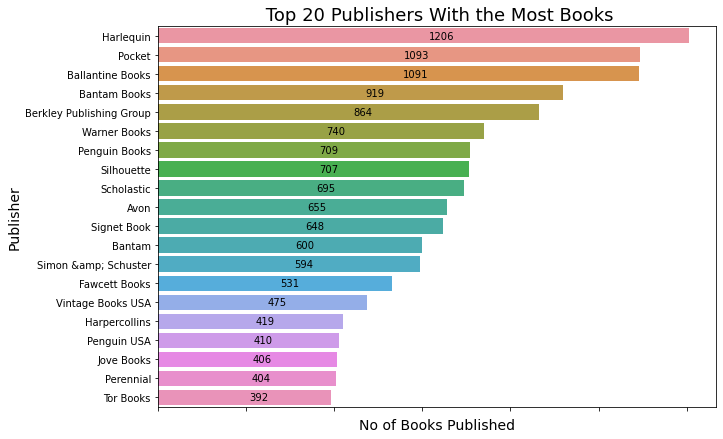

In [66]:
b = count.sort_values(by=['count'], ascending = False)
b = b.head(20)
x =['Harlequin','Silhouette','Pocket','Ballantine Books','Bantam Books','Scholastic','Simon &amp; Schuster']
y = [7537,4220,3905,3783,3646,3160,2971]
fig=plt.figure(figsize=(10,7))
ax = sns.barplot(x = 'count',y = 'c' , data = b)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90,horizontalalignment='center')
plt.xlabel("No of Books Published", size=14)
plt.ylabel("Publisher", size=14)
plt.title(" Top 20 Publishers With the Most Books", size=18)
for p in ax.patches:
    ax.annotate("%.0f" % p.get_width(), xy=(p.get_width()/2, p.get_y()+p.get_height()/2),
            xytext=(5, 0), textcoords='offset points', ha="left", va="center")
plt.show()

In [67]:
np.set_printoptions(threshold=np.inf)
books["Year-Of-Publication"].unique()

array([2002, 2001, 1991, 1999, 2000, 1993, 1996, 1988, 2004, 1998, 1994,
       2003, 1997, 1983, 1979, 1995, 1982, 1985, 1992, 1986, 1978, 1980,
       1952, 1987, 1990, 1981, 1989, 1984,    0, 1968, 1961, 1958, 1974,
       1976, 1971, 1977, 1975, 1965, 1941, 1970, 1962, 1973, 1972, 1960,
       1966, 1920, 1956, 1959, 1953, 1951, 1942, 1963, 1964, 1969, 1954,
       1950, 1967, 2005, 1957, 1940, 1937, 1955, 1946, 1936, 1930, 2011,
       1925, 1948, 1943, 1947, 1945, 1923, 2020, 1939, 1926, 1938, 2030,
       1911, 1904, 1949])

we can see that the years are object type and we have zeros as well as there is some error by including names in years 

In [68]:
index=books.loc[books["Year-Of-Publication"]=='DK Publishing Inc'].index
books.drop(index,inplace=True)
index=books.loc[books["Year-Of-Publication"]=='Gallimard'].index
books.drop(index,inplace=True)
books["Year-Of-Publication"].replace({'0':books["Year-Of-Publication"].value_counts().idxmax()},inplace=True)
books["Year-Of-Publication"] = books["Year-Of-Publication"].astype(str).astype(int)
books["Year-Of-Publication"].unique()

array([2002, 2001, 1991, 1999, 2000, 1993, 1996, 1988, 2004, 1998, 1994,
       2003, 1997, 1983, 1979, 1995, 1982, 1985, 1992, 1986, 1978, 1980,
       1952, 1987, 1990, 1981, 1989, 1984,    0, 1968, 1961, 1958, 1974,
       1976, 1971, 1977, 1975, 1965, 1941, 1970, 1962, 1973, 1972, 1960,
       1966, 1920, 1956, 1959, 1953, 1951, 1942, 1963, 1964, 1969, 1954,
       1950, 1967, 2005, 1957, 1940, 1937, 1955, 1946, 1936, 1930, 2011,
       1925, 1948, 1943, 1947, 1945, 1923, 2020, 1939, 1926, 1938, 2030,
       1911, 1904, 1949])

/Users/azizfall/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


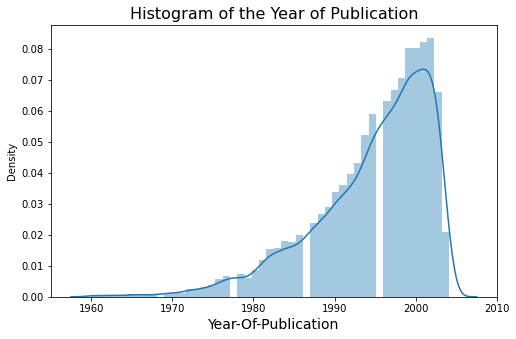

In [69]:
fig=plt.figure(figsize=(8,5))
y1 = books[books["Year-Of-Publication"] >= 1960]
y1 = y1[y1["Year-Of-Publication"] <= 2005]
sns.distplot(y1["Year-Of-Publication"])
plt.xlabel("Year-Of-Publication",size=14)
plt.title('Histogram of the Year of Publication',size=16)
plt.show()

Now we will analyse users dataset

In [70]:
print(users.shape)
users.columns=['UserID','Location','Age']
users.head()

(69444, 3)


,UserID,Location,Age
0,2,"stockton, california, usa",18.0
1,8,"timmins, ontario, canada",NaN
2,9,"germantown, tennessee, usa",NaN
3,10,"albacete, wisconsin, spain",26.0
4,12,"fort bragg, california, usa",NaN


In [71]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69444 entries, 0 to 69443
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   UserID    69444 non-null  int64  
 1   Location  69444 non-null  object 
 2   Age       40668 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 1.6+ MB


we will check for null values

In [72]:
L=((users.isnull().sum()).sort_values()).to_dict()
for i in L:
    print(i,"--->",L[i])  

UserID ---> 0
Location ---> 0
Age ---> 28776


In [73]:
users['Age'].fillna(users['Age'].value_counts().idxmax(),inplace=True)
for i in users['Age'][users['Age']>95]:
        users['Age'].replace({i:users['Age'].value_counts().idxmax()},inplace=True)
for i in users['Age'][users['Age']==0]:
        users['Age'].replace({i:users['Age'].value_counts().idxmax()},inplace=True)
users['Age'] = users['Age'].astype(int) 
users['Age'].unique()

array([18, 26, 14, 19, 24, 17, 51, 34, 32, 43, 44, 37, 20, 41, 42, 57, 49,
       47, 38, 45, 35, 62, 28, 27, 33, 23, 15, 21, 16, 25, 53, 59, 63, 22,
       29, 40, 48, 72, 31, 58, 69, 55, 36, 13, 30, 50, 56, 52, 46,  9, 39,
       71, 74, 54, 61, 75, 60,  3,  1, 64, 66, 83, 11, 68,  2, 12, 65, 77,
       73, 70,  8, 76, 78, 67, 93, 79, 80, 82,  7, 84, 81, 10,  4, 92, 85,
       90, 86,  5,  6, 94])

we have cleaned the age values  

/Users/azizfall/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


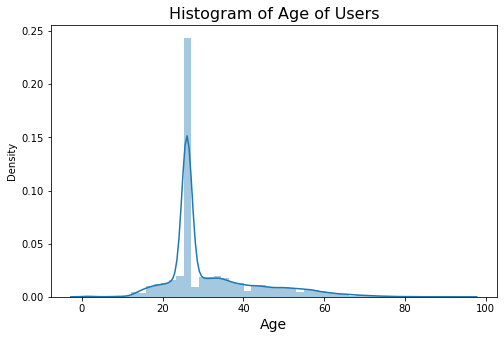

In [74]:
fig=plt.figure(figsize=(8,5))
sns.distplot(users['Age'])
plt.xlabel('Age',size=14)
plt.title('Histogram of Age of Users',size=16)
plt.show()

In [75]:
users['Location']

0          stockton, california, usa
1           timmins, ontario, canada
2         germantown, tennessee, usa
3         albacete, wisconsin, spain
4        fort bragg, california, usa
                    ...             
69439       st. paul, minnesota, usa
69440       toronto, ontario, canada
69441    georgetown, ontario, canada
69442             dallas, texas, usa
69443          portland, oregon, usa
Name: Location, Length: 69444, dtype: object

In [76]:
#users[['id', 'city','state','country']]=users['Location'].apply(lambda x: pd.Series(str(x).split(",")))
#users.drop(['Location','nan'],axis=1,inplace=True)
#users

now we will analyse the ratings columns

In [77]:
print(ratings.shape)
ratings.columns=['UserID','ISBN','Rating']
ratings.head()

(575880, 3)


,UserID,ISBN,Rating
0,276725,034545104X,0
1,276727,0446520802,0
2,276744,038550120X,7
3,276746,0425115801,0
4,276746,0449006522,0


In [78]:
ratings['Rating'].unique()

array([ 0,  7,  9,  8,  5, 10,  6,  2,  3,  4,  1])

In [79]:
filter1 = ratings[ratings["UserID"].isin(users["UserID"])] 
df_ratings=filter1[filter1["ISBN"].isin(books["ISBN"])] 
df=pd.merge(users,df_ratings,on='UserID')
df

,UserID,Location,Age,ISBN,Rating
0,2,"stockton, california, usa",18,0195153448,0
1,8,"timmins, ontario, canada",26,0002005018,5
2,8,"timmins, ontario, canada",26,0060973129,0
3,8,"timmins, ontario, canada",26,0374157065,0
4,8,"timmins, ontario, canada",26,0393045218,0
...,...,...,...,...,...
575875,278854,"portland, oregon, usa",26,0375703063,7
575876,278854,"portland, oregon, usa",26,042516098X,7
575877,278854,"portland, oregon, usa",26,0515087122,0
575878,278854,"portland, oregon, usa",26,0553578596,0


here we merged the ratings and users dataset on UserID

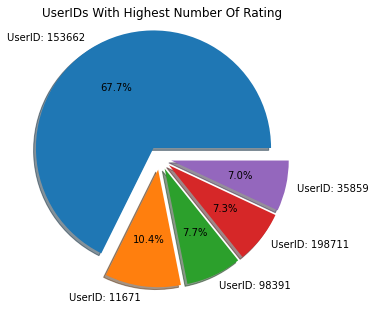

In [80]:
# Pie chart showing countries with most number of users 
my_dict=(df_ratings['Rating'].value_counts()).to_dict()
count= pd.DataFrame(list(my_dict.items()),columns = ['c','count'])
a = count.sort_values(by=['count'], ascending = False)
a.head(7)
labels = 'UserID: 153662','UserID: 11671','UserID: 98391','UserID: 198711','UserID: 35859'
sizes = [count['count'].iloc[0],count['count'].iloc[1],count['count'].iloc[2],count['count'].iloc[3],count['count'].iloc[4]]
explode = (0.1, 0.1, 0.1, 0.1,0.1)

fig1 , ax1 = plt.subplots(figsize=(5,5))

ax1.pie(sizes,
        explode = explode,
        labels = labels,
        autopct = '%1.1f%%',
        shadow = True,
        startangle = 0)
plt.title("UserIDs With Highest Number Of Rating")
ax1.axis ('equal')

plt.show()

In [81]:
#my_dict=(users['country'].value_counts()).to_dict()
#count= pd.DataFrame(list(my_dict.items()),columns = ['c','count'])
#f = count.sort_values(by=['count'], ascending = False)
#f = f.head(15)
#f.drop(7,inplace=True)
#fig=plt.figure(figsize=(10,5))
#ax = sns.barplot(y = 'count',x= 'c' , data = f)
#ax.set_xticklabels(ax.get_xticklabels(), rotation=90,horizontalalignment='center')
#for bar in ax.patches: 
#    ax.annotate(format(bar.get_height(), '.0f'),  
#                   (bar.get_x() + bar.get_width() / 2,  
#                    bar.get_height()), ha='center', va='center', 
#                   size=8, xytext=(0,8), 
#                   textcoords='offset points') 
#plt.xlabel("Country", size=14)
#plt.ylabel("No of Users", size=14)
#plt.title("Countries With Most Users", size=18)
#plt.show()

In [82]:
# Pie chart showing countries with most number of users 
# my_dict=(users['country'].value_counts()).to_dict()
# count= pd.DataFrame(list(my_dict.items()),columns = ['c','count'])
# a = count.sort_values(by=['count'], ascending = False)
# a.head(7)
# labels = 'United Kingdom','Australia','USA','Germany','Italy','Canada','Spain'
# sizes = [count['count'].iloc[2],count['count'].iloc[5],count['count'].iloc[0],count['count'].iloc[3],count['count'].iloc[6],
#          count['count'].iloc[1],count['count'].iloc[4]]
# explode = (0.1, 0.1, 0.1, 0.1,0.1, 0.1,0.1 )

# fig1 , ax1 = plt.subplots(figsize=(7,7))

# ax1.pie(sizes,
#         explode = explode,
#         labels = labels,
#         autopct = '%1.1f%%',
#         shadow = True,
#         startangle = 0)
# plt.title("Top 7 Countries With the Most Users")
# ax1.axis ('equal')

# plt.show()

In [83]:
# coun=[]
# for country in df["country"].unique():
#     coun.append(country)
# import pycountry
# def do_fuzzy_search(country):
#     result = pycountry.countries.search_fuzzy(country)
#     return result[0].alpha_3
# iso_map=[]
# c=[]
# for i in coun:
#     try:
#         iso_map.append(do_fuzzy_search(i))
#         c.append(i)
#     except:
#         iso_map.append('unknown')
#         c.append(i)
#         continue
# df1=pd.DataFrame(iso_map,c,columns=['code'])
# df1

In [84]:
# l=list(df1.index)
# country_code=[]
# for i in df['country']:
#     if i in l:
#         country_code.append(df1['code'].loc[df1.index==i][0])
# df['Country_Code'] = np.array(country_code)

In [85]:
# import pycountry
# grouped = df.groupby(['Country_Code','country'])
# avg=pd.DataFrame(grouped['Rating'].agg(np.mean))
# avg.reset_index(inplace=True)
# avg.columns=['Country Code','Country','Average Rating']
# import plotly.express as px
# fig = px.choropleth(avg, locations=avg['Country Code'],color=avg['Average Rating'],hover_name=avg['Country'],
#                     color_continuous_scale=px.colors.sequential.Plasma)
# fig.show()

the above map shows the average ratings given by users of a country

In [86]:
# import pycountry
# grouped = df.groupby(['Country_Code','country'])
# avg=pd.DataFrame(grouped['Age'].agg(np.mean))
# avg.reset_index(inplace=True)
# avg.columns=['Country Code','Country','Average Age']
# import plotly.express as px
# fig = px.choropleth(avg, locations=avg['Country Code'],color=avg['Average Age'],hover_name=avg['Country'],
#                     color_continuous_scale=px.colors.sequential.Plasma)
# fig.show()

the above map shows the average age of users of a country

<h2>Popularity Based Recommendation</h2>

recommendations of the books are made based on their popularity among users

In [87]:
a=df[df['Rating']>0]
grouped = a.groupby('ISBN')
popular_books = pd.DataFrame(grouped['Rating'].agg([np.size, np.mean]))
most_popular = popular_books.sort_values(['mean'], ascending=False)
pop=most_popular[most_popular['size']>200]
pop_title=list(pop[:10].index)
titles=[]
for i in pop_title:
    titles.append(books["Book-Title"].loc[books['ISBN']==i].values[0])
index=1
for i in titles:
    print(index,'. ',i)
    index+=1

1 .  Harry Potter and the Order of the Phoenix (Book 5)
2 .  To Kill a Mockingbird
3 .  Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))
4 .  The Secret Life of Bees
5 .  The Da Vinci Code
6 .  The Lovely Bones: A Novel
7 .  The Red Tent (Bestselling Backlist)
8 .  The Poisonwood Bible: A Novel
9 .  Where the Heart Is (Oprah's Book Club (Paperback))
10 .  Angels &amp; Demons


<h2>Content Based Recommendation</h2>

here we use a dataset with descriptions of books given to recommend to users new books based on their previous preference 

In [88]:
data1

,Book-Title,Description
0,Classical Mythology,"Originally published: Handbook of classical mythology. Santa Barbara, CA: ABC-CLIO, c2004.\n"
1,Clara Callan,"In a small town in Canada, Clara Callan reluctantly takes leave of her sister, Nora, who is bound for New York. It's a time when the growing threat of fascism in Europe is a constant worry, and people escape from reality through radio and the movies. Meanwhile, the two sisters -- vastly different in personality, yet inextricably linked by a shared past -- try to find their places within the complex web of social expectations for young women in the 1930s. While Nora embarks on a glamorous career as a radio-soap opera star, Clara, a strong and independent-minded woman, struggles to observe the traditional boundaries of a small and tight-knit community without relinquishing her dreams of love, freedom, and adventure. However, things aren't as simple as they appear -- Nora's letters eventually reveal life in the big city is less exotic than it seems, and the tranquil solitude of Clara's life is shattered by a series of unforeseeable events. These twists of fate require all of Clara's courage and strength, and finally put the seemingly unbreakable bond between the sisters to the test.\n"
2,Decision in Normandy,"“The best-researched, best-written account [of the Normandy Campaign] I have ever read.”—Drew Middleton, The New York Times Book Review One of the most controversial and dangerous military operations in the history of modern warfare, the battle for Normandy took over two years of planning from each country that made up the Allied forces. Mired to this day in myth and misconception, untangling the web of work that led to D-Day is nearly as daunting as the work that led to the day itself. Drawing from declassified documents, personal interviews, diaries, and more, Carlo D’Este uncovers what really happened in Normandy. From what went right to what went wrong, D’Este takes readers on a journey from the very first moment Prime Minister Churchill considered an invasion through France to the last battles of World War II. Loaded with photos, maps, and first-hand accounts, readers can trace the incredible road to victory and the intricate battles in-between. A comprehensive look into the military strategy surrounding the second World War, Decision in Normandy is an absolute essential for history buffs.\n"
3,Flu: The Story of the Great Influenza Pandemic of 1918 and the Search for the Virus That Caused It,"The fascinating, true story of the world's deadliest disease. In 1918, the Great Flu Epidemic felled the young and healthy virtually overnight. An estimated forty million people died as the epidemic raged. Children were left orphaned and families were devastated. As many American soldiers were killed by the 1918 flu as were killed in battle during World War I. And no area of the globe was safe. Eskimos living in remote outposts in the frozen tundra were sickened and killed by the flu in such numbers that entire villages were wiped out. Scientists have recently rediscovered shards of the flu virus frozen in Alaska and preserved in scraps of tissue in a government warehouse. Gina Kolata, an acclaimed reporter for The New York Times, unravels the mystery of this lethal virus with the high drama of a great adventure story. Delving into the history of the flu and previous epidemics, detailing the science and the latest understanding of this mortal disease, Kolata addresses the prospects for a great epidemic recurring, and, most important, what can be done to prevent it.\n"
4,The Mummies of Urumchi,"A look at the incredibly well-preserved ancient mummies found in Western China describes their clothing and appearance, attempts to reconstruct their culture, and speculates about how Caucasians could have found their way to the feet of the Himalayan mountains. Reprint.\n"
...,...,...
49987,Taste of Quebec,"Canada’s culinary treasure revealed in recipes, stories and photographs Canada has

In [89]:
data1['Description'] =data1['Description'].astype(str)
data1['len']=data1['Description'].apply(lambda x:len(x.split(' ')))
bookdf=data1[data1['len']>=50]
bookdf.shape

(25087, 3)

In [34]:
import spacy as sp
sp.prefer_gpu()
import en_core_web_sm
nlp = en_core_web_sm.load()
import re
def clean_text(doc):
    #Clean the document. Remove pronouns, stopwords, lemmatize the words and lowercase them
    doc = nlp(doc)
    tokens = []
    exclusion_list = ["nan"]
    for token in doc:
        if token.is_stop or token.is_punct or token.text.isnumeric() or (token.text.isalnum()==False) or token.text in exclusion_list :
            continue
        token = str(token.lemma_.lower().strip())
        tokens.append(token)
    return " ".join(tokens) 
bookdf['cleaned_description']=bookdf.apply(lambda row: clean_text(row["Description"]) ,axis=1)
bookdf.reset_index(inplace=True)

In [35]:
newdf=bookdf[["Book-Title",'Description','cleaned_description']]

In [36]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
newdf['title_id']=le.fit_transform(newdf['Book-Title'])
contentdf=newdf[['title_id','Book-Title','Description','cleaned_description']]
contentdf=contentdf.set_index('title_id')
contentdf.reset_index(inplace=True)
#contentdf.drop(['index'],axis=1,inplace=True)
contentdf

,title_id,Book-Title,Description,cleaned_description
0,3434,Clara Callan,"In a small town in Canada, Clara Callan reluctantly takes leave of her sister, Nora, who is bound for New York. It's a time when the growing threat of fascism in Europe is a constant worry, and people escape from reality through radio and the movies. Meanwhile, the two sisters -- vastly different in personality, yet inextricably linked by a shared past -- try to find their places within the complex web of social expectations for young women in the 1930s. While Nora embarks on a glamorous career as a radio-soap opera star, Clara, a strong and independent-minded woman, struggles to observe the traditional boundaries of a small and tight-knit community without relinquishing her dreams of love, freedom, and adventure. However, things aren't as simple as they appear -- Nora's letters eventually reveal life in the big city is less exotic than it seems, and the tranquil solitude of Clara's life is shattered by a series of unforeseeable events. These twists of fate require all of Clara's courage and strength, and finally put the seemingly unbreakable bond between the sisters to the test.\n",small town canada clara callan reluctantly take leave sister nora bind new york time grow threat fascism europe constant worry people escape reality radio movie sister vastly different personality inextricably link share past try find place complex web social expectation young woman 1930 nora embark glamorous career radio soap opera star clara strong independent minded woman struggle observe traditional boundary small tight knit community relinquish dream love freedom adventure thing simple appear nora letter eventually reveal life big city exotic tranquil solitude clara life shatter series unforeseeable event twist fate require clara courage strength finally seemingly unbreakable bond sister test
1,4458,Decision in Normandy,"“The best-researched, best-written account [of the Normandy Campaign] I have ever read.”—Drew Middleton, The New York Times Book Review One of the most controversial and dangerous military operations in the history of modern warfare, the battle for Normandy took over two years of planning from each country that made up the Allied forces. Mired to this day in myth and misconception, untangling the web of work that led to D-Day is nearly as daunting as the work that led to the day itself. Drawing from declassified documents, personal interviews, diaries, and more, Carlo D’Este uncovers what really happened in Normandy. From what went right to what went wrong, D’Este takes readers on a journey from the very first moment Prime Minister Churchill considered an invasion through France to the last battles of World War II. Loaded with photos, maps, and first-hand accounts, readers can trace the incredible road to victory and the intricate battles in-between. A comprehensive look into the military strategy surrounding the second World War, Decision in Normandy is an absolute essential for history buffs.\n",well research well write account normandy campaign read middleton new york times book review controversial dangerous military operation history modern warfare battle normandy take year planning country allied force mire day myth misconception untangle web work lead d day nearly daunt work lead day draw declassified document personal interview diary carlo uncover happen normandy go right go wrong take reader journey moment prime minister churchill consider invasion france battle world war ii load photo map hand account reader trace incredible road victory intricate battle comprehensive look military strategy surround second world war decision normandy absolute essential history buff
2,6257,Flu: The Story of the Great Influenza Pandemic of 1918 and the Search for the Virus That Caused It,"The fascinating, true story of the world's deadliest disease. In 1918, the Great Flu Epidemic felled the young and healthy virtually overnight. An estimated forty million people

In [37]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import linear_kernel
tfidf = TfidfVectorizer(sublinear_tf=True, min_df=3,ngram_range=(1, 3), stop_words='english')
tfidf_description = tfidf.fit_transform((contentdf["cleaned_description"])) 
print("Each of the %d text is represented by %d features (TF-IDF score of unigrams and bigrams)" %(tfidf_description.shape))
# Finding cosine similarity between vectors 
from sklearn.metrics.pairwise import cosine_similarity 
cos_sim = linear_kernel(tfidf_description, tfidf_description) 

Each of the 25087 text is represented by 246066 features (TF-IDF score of unigrams and bigrams)


In [38]:
indices = pd.Series(contentdf.index) 
def recommendations(title, cosine_sim = cos_sim): 
    recommended_book = [] 
    index = indices[indices == title].index[0]
    similarity_scores = pd.Series(cosine_sim[index]).sort_values(ascending = False) 
    top_10_books = list(similarity_scores.iloc[1:11].index)
    for i in top_10_books: 
        recommended_book.append(list(contentdf.index)[i]) 
    top_5_books=[]
    for i in recommended_book:
        if i not in top_5_books and i!=title:
            top_5_books.append(i)
    recommendbook=[]
    for i in top_5_books:
        recommendbook.append(contentdf["Book-Title"][i])
    return recommendbook

In [51]:
books = ['Mere Christianity: A revised and enlarged edition, with a new introduction, of the three books, The case for Christianity, Christian behaviour, and Beyond personality', "Aunt Dimity's Death (Aunt Dimity (Paperback))", 'Pride and Prejudice (The Penguin English Library, El 72)', 'All Things Bright and Beautiful (All Things Bright &amp; Beautiful)', 'Dragonquest', '101 Dalmatians', 'The Street Lawyer', 'The Warlock in Spite of Himself', 'Miss Melville Regrets', 'Not a Penny More 4', 'Pride and Prejudice', 'All Things Bright and Beautiful', 'Lord God Made Them All', 'Dragonsinger', 'A Most Contagious Game', 'The Thin Woman', 'To Say Nothing of the Dog', "Charlotte's Web", "Harry Potter and the Sorcerer's Stone (Book 1)", 'DAUGHTER OF TIME', 'Gift from the Sea', 'The Wind in the Willows (Aladdin Classics)']

for book in books:
    a=contentdf.loc[contentdf['Book-Title']==book]
    if a.empty:
        continue
    print("Title of Rated Book of User3 with Rating=10: ",book)
    id=a.index[0]
    r=recommendations(id)
    print("*****Here are a few recommendations for you*****")
    for i,j in zip(r,range(1,len(r)+1)):
        print(j,".",i)
    print("\n")
        

Title of Rated Book of User3 with Rating=10:  Aunt Dimity's Death (Aunt Dimity (Paperback))
*****Here are a few recommendations for you*****
1 . Aunt Dimity Takes a Holiday
2 . Aunt Dimity: Detective (Aunt Dimity (Hardcover))
3 . Aunt Dimity Beats the Devil (Aunt Dimity (Hardcover))
4 . Aunt Dimity and the Duke (Penguin Crime Fiction)
5 . Aunt Dimity Digs in (Aunt Dimity (Paperback))
6 . Aunt Dimity's Christmas (Aunt Dimity (Hardcover))
7 . Bedtime Stories for Grown-Ups
8 . Baby Wanted (Montana Mavericks #10) (Montana Mavericks)
9 . Whatever Tomorrow Brings (The Californians, Bk. 1)
10 . The Callender Papers


Title of Rated Book of User3 with Rating=10:  101 Dalmatians
*****Here are a few recommendations for you*****
1 . 101 Dalmatians
2 . 101 Dalmatians
3 . Persuader: A Jack Reacher Novel
4 . Bloodlines (Dog Lover's Mysteries)
5 . A Home for Jessie
6 . Guide to Training Your Own Dog: Housebreaking, Tricks, Basic Obedience, Behavior Modification, Fully Illustrated (Re Dog Series)
7 . 

<h2>Collabrative Filtering Based Recommendation</h2>

here we recommend books to users who have already rated a few books 

In [107]:
df=df[df['Rating']>0]

In [108]:
counts1 = df['UserID'].value_counts()
df= df[df['UserID'].isin(counts1[counts1 > 200].index)]
df

,UserID,Location,Age,ISBN,Rating
9903,4385,"albq, new mexico, usa",33,0061083402,10
9905,4385,"albq, new mexico, usa",33,0061093343,9
9906,4385,"albq, new mexico, usa",33,0061096156,10
9908,4385,"albq, new mexico, usa",33,0312956762,10
9909,4385,"albq, new mexico, usa",33,0312980353,10
9914,4385,"albq, new mexico, usa",33,0345446100,10
9915,4385,"albq, new mexico, usa",33,0373024665,10
9916,4385,"albq, new mexico, usa",33,0373025920,10
9920,4385,"albq, new mexico, usa",33,0373032072,10
9921,4385,"albq, new mexico, usa",33,0373035101,10


In [109]:
len(df['ISBN'].unique())

12014

In [110]:
cdf1=df[['UserID','ISBN','Rating']]
cdf=pd.merge(cdf1,books,on='ISBN')
cdf

,UserID,ISBN,Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-M
0,4385,0061083402,10,The Bandit's Lady (Harper Monogram),Maureen Child,1995,Harper Mass Market Paperbacks (Mm),http://images.amazon.com/images/P/0061083402.01.MZZZZZZZ.jpg
1,4385,0061093343,9,Fault Lines,Anne Rivers Siddons,1996,HarperTorch,http://images.amazon.com/images/P/0061093343.01.MZZZZZZZ.jpg
2,11676,0061093343,8,Fault Lines,Anne Rivers Siddons,1996,HarperTorch,http://images.amazon.com/images/P/0061093343.01.MZZZZZZZ.jpg
3,4385,0061096156,10,Society of the Mind: A Cyberthriller,Eric L. Harry,1997,Harper Mass Market Paperbacks (Mm),http://images.amazon.com/images/P/0061096156.01.MZZZZZZZ.jpg
4,4385,0312956762,10,Die Hard: With a Vengeance - A Novel,D. Chiel,1995,St Martins Pr,http://images.amazon.com/images/P/0312956762.01.MZZZZZZZ.jpg
5,4385,0312980353,10,Circle of Stars,Anna Lee Waldo,2002,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312980353.01.MZZZZZZZ.jpg
6,4385,0345446100,10,"Edge of Victory II: Rebirth (Star Wars: The New Jedi Order, Book 8)",Greg Keyes,2001,Del Rey Books,http://images.amazon.com/images/P/0345446100.01.MZZZZZZZ.jpg
7,4385,0373024665,10,Dark Enigma (Harlequin Romance),Rebecca Stratton,1982,Harlequin Books,http://images.amazon.com/images/P/0373024665.01.MZZZZZZZ.jpg
8,4385,0373025920,10,No Room In His Lif (Harlequin Romance),Nicola West,1983,Harlequin,http://images.amazon.com/images/P/0373025920.01.MZZZZZZZ.jpg
9,4385,0373032072,10,"Man Of Truth (Harlequin Romance, No 3207)",Jessica Marchant,1992,Harlequin,http://images.amazon.com/images/P/0373032072.01.MZZZZZZZ.jpg


In [111]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
cdf['User_ID']=le.fit_transform(cdf['UserID'])
print(cdf[cdf['User_ID'] == 3])
cdf['title_id']=le.fit_transform(cdf['Book-Title'])
cdf.drop('UserID',axis=1,inplace=True)
cdf

      UserID        ISBN  Rating  \
156     7346  0440221471       9   
325     7346  0312980140       8   
474     7346  0440952522       7   
514     7346  0553560247       8   
694     7346  0060987103       7   
710     7346  014018869X       6   
730     7346  014029628X       8   
782     7346  0312265867       6   
790     7346  0312966970       8   
882     7346  0380977788       9   
986     7346  0609804138       7   
995     7346  0671001795       8   
1054    7346  0684822652       8   
1062    7346  0743227441       9   
1073    7346  0804106304       9   
1080    7346  080410753X       8   
1169    7346  0020198906       8   
1170    7346  0020868308      10   
1172    7346  0028604199       8   
1174    7346  0060096195       8   
1178    7346  0060199296       7   
1179    7346  0060507772       9   
1180    7346  0060675187       8   
1181    7346  0060912596       8   
1182    7346  0060919833       8   
1183    7346  0060974443       7   
1184    7346  0060989238    

,ISBN,Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-M,User_ID,title_id
0,0061083402,10,The Bandit's Lady (Harper Monogram),Maureen Child,1995,Harper Mass Market Paperbacks (Mm),http://images.amazon.com/images/P/0061083402.01.MZZZZZZZ.jpg,0,8021
1,0061093343,9,Fault Lines,Anne Rivers Siddons,1996,HarperTorch,http://images.amazon.com/images/P/0061093343.01.MZZZZZZZ.jpg,0,2989
2,0061093343,8,Fault Lines,Anne Rivers Siddons,1996,HarperTorch,http://images.amazon.com/images/P/0061093343.01.MZZZZZZZ.jpg,4,2989
3,0061096156,10,Society of the Mind: A Cyberthriller,Eric L. Harry,1997,Harper Mass Market Paperbacks (Mm),http://images.amazon.com/images/P/0061096156.01.MZZZZZZZ.jpg,0,7375
4,0312956762,10,Die Hard: With a Vengeance - A Novel,D. Chiel,1995,St Martins Pr,http://images.amazon.com/images/P/0312956762.01.MZZZZZZZ.jpg,0,2388
5,0312980353,10,Circle of Stars,Anna Lee Waldo,2002,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312980353.01.MZZZZZZZ.jpg,0,1764
6,0345446100,10,"Edge of Victory II: Rebirth (Star Wars: The New Jedi Order, Book 8)",Greg Keyes,2001,Del Rey Books,http://images.amazon.com/images/P/0345446100.01.MZZZZZZZ.jpg,0,2654
7,0373024665,10,Dark Enigma (Harlequin Romance),Rebecca Stratton,1982,Harlequin Books,http://images.amazon.com/images/P/0373024665.01.MZZZZZZZ.jpg,0,2106
8,0373025920,10,No Room In His Lif (Harlequin Romance),Nicola West,1983,Harlequin,http://images.amazon.com/images/P/0373025920.01.MZZZZZZZ.jpg,0,5865
9,0373032072,10,"Man Of Truth (Harlequin Romance, No 3207)",Jessica Marchant,1992,Harlequin,http://images.amazon.com/images/P/0373032072.01.MZZZZZZZ.jpg,0,5147


In [95]:
from surprise import Reader
reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(cdf[['User_ID','title_id','Rating']], reader)
svd = SVD()
cross_validate(svd, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)


Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.5615  1.5930  1.5562  1.6201  1.5651  1.5792  0.0241  
MAE (testset)     1.1732  1.1786  1.1600  1.2083  1.1759  1.1792  0.0159  
Fit time          0.60    0.61    0.58    0.66    0.77    0.64    0.07    
Test time         0.01    0.01    0.01    0.02    0.02    0.01    0.00    


{'test_rmse': array([1.56148087, 1.5930436 , 1.55617067, 1.62012311, 1.5651394 ]),
 'test_mae': array([1.17319505, 1.1785785 , 1.16003372, 1.20827222, 1.17593046]),
 'fit_time': (0.5975239276885986,
  0.6122350692749023,
  0.5764949321746826,
  0.6642823219299316,
  0.7736501693725586),
 'test_time': (0.014121055603027344,
  0.012607097625732422,
  0.013310909271240234,
  0.018397092819213867,
  0.016021013259887695)}

In [96]:
def user_rec(id):
    user= cdf[['ISBN','Book-Title','Book-Author','Year-Of-Publication','Publisher','title_id']].copy()
    user = user.reset_index()
# getting full dataset
    data = Dataset.load_from_df(cdf[['User_ID','title_id','Rating']], reader)
    trainset = data.build_full_trainset()
    svd.fit(trainset)
    user['Estimate_Score'] = user['title_id'].apply(lambda x: svd.predict(id, x).est)
    user = user.drop(['index','title_id'], axis = 1)
    user= user.sort_values('Estimate_Score' , ascending = False)
    counts1 = user['Estimate_Score'].value_counts()
    user = user[user['Estimate_Score'].isin(counts1[counts1 == 1].index)]
    return user.head(10)

In [97]:
pd.set_option('display.max_rows',None) 
Uid=3
print("THE ID OF THE USER: ",Uid)
details=cdf.loc[cdf['User_ID']==Uid]
id=details['User_ID'].iloc[0]
a=user_rec(id)
a.reset_index(inplace=True)
a.drop(['index'],axis=1,inplace=True)
details.reset_index(inplace=True)
details
details.drop(['index','User_ID','title_id','ISBN'],axis=1,inplace=True)
print("\n********************************************USER HAS RATED THESE BOOKs******************************************************")
title_1=list(details['Book-Title'])
rat1=list(details['Rating'])

ratings_w_10 = []
for i,j in zip(title_1,rat1):
    print(i,'=>',j)
    if int(j) == 10:
        ratings_w_10.append(i)
    
print("\n****************HERE ARE A FEW RECOMMENDATIONS FOR THE USER WITH THE  MOST ESTIMATED POINTS THE USER WILL GIVE******************")
print("\n")
print(ratings_w_10)
print("\n")
print("Length of ratings with 10 is: ", len(ratings_w_10))

display(a)

THE ID OF THE USER:  3

********************************************USER HAS RATED THESE BOOKs******************************************************
The Runaway Jury => 9
Seven Up (A Stephanie Plum Novel) => 8
MANY WATERS => 7
Dying for Chocolate (Culinary Mysteries (Paperback)) => 8
Wicked: The Life and Times of the Wicked Witch of the West => 7
Cold Comfort Farm => 6
Girl in Hyacinth Blue => 8
To the Nines: A Stephanie Plum Novel => 6
Four To Score (A Stephanie Plum Novel) => 8
Coraline => 9
The Sweet Potato Queens' Book of Love => 7
Two for the Dough => 8
THREE TO GET DEADLY : A Stephanie Plum Novel => 8
The Other Boleyn Girl => 9
The Joy Luck Club => 9
The Kitchen God's Wife => 8
Joshua => 8
Mere Christianity: A revised and enlarged edition, with a new introduction, of the three books, The case for Christianity, Christian behaviour, and Beyond personality => 10
Once upon a More Enlightened Time: More Politically Correct Bedtime Stories => 8
The Boy Next Door => 8
Today I Am a Ma'Am

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Estimate_Score
0,0689831404,The Wind in the Willows (Aladdin Classics),Kenneth Grahame,1999,Aladdin,8.723622
1,0380006286,101 Dalmatians,Dodie Smith,1982,Harpercollins Juvenile Books,8.624398
2,0449212599,Miss Melville Regrets,Evelyn E. Smith,1987,Random House,8.607415
3,0679732411,Gift from the Sea,Anne Morrow Lindbergh,1991,Pantheon Books,8.545339
4,0060391626,I Know This Much Is True (Oprah's Book Club),Wally Lamb,1998,Regan Books,8.531636
5,0140178406,Aunt Dimity's Death (Aunt Dimity (Paperback)),Nancy Atherton,1993,Penguin Books,8.529500
6,0553205587,Lord God Made Them All,James Herriot,1982,Bantam Doubleday Dell,8.501076
7,0312963009,Neanderthal: A Novel,John Darnton,1997,St. Martin's Press,8.481391
8,0553240838,A Most Contagious Game,Catherine Aird,1983,Bantam Books,8.471568
9,0515060712,Killer Dolphin,Ngaio Marsh,1981,Jove Books,8.468873
